In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import scipy.sparse.linalg
import matplotlib.pyplot as plt
import matplotlib.colors
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures

from numba import njit,prange
from numba.typed import List

In [2]:
full_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[41.,50.],'lonlim':[0.,20.]}
normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
EUROCORDEX_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[42.5,49],'lonlim':[2.5,16.5]}

imin = 15 ; imax = -23
jmin = 10 ; jmax = -6

ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-MPI-ESM1-2-HR/MARgrid_EUy.nc')

lon_ = ds.LON.data[jmin:jmax,imin:imax]
lat_ = ds.LAT.data[jmin:jmax,imin:imax]
H_ = ds.SH.data[jmin:jmax,imin:imax]

In [3]:
# simulation = '/bettik/beaumetj/MARout/MAR-ERA-20C/daily/ICE.ERA-20C_v1.EUf.'
simulation = '/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.'

# simulation = '/bettik/beaumetj/MARout/MAR-MPI-ESM1-2-HR/HIST/daily/ICE.MPI-ESM_HIST.EUy.'
# simulation = '/bettik/beaumetj/MARout/MAR-MPI-ESM1-2-HR/SSP585/daily/ICE.MPI-ESM_SSP585.EUy.'

# simulation = '/bettik/beaumetj/MARout/MAR-EC-Earth3/HIST/daily/ICE.EC-Earth3_HIST.EUe.'
# simulation = '/bettik/beaumetj/MARout/MAR-EC-Earth3/SSP245/daily/ICE.EC-Earth3_SSP245.EUe.'

In [4]:
ds_rr = xr.open_mfdataset(simulation+'MBrr.*.nc')
ds_sf = xr.open_mfdataset(simulation+'MBsf.*.nc')
P = np.array(ds_rr.MBrr.data[:,jmin:jmax,imin:imax] + ds_sf.MBsf.data[:,jmin:jmax,imin:imax])
print(np.shape(P))
dates = ds_rr.MBrr.time
np_dates = np.transpose(np.array([dates.dt.year,dates.dt.month,dates.dt.day,np.mean(P,(1,2)),np.max(P,(1,2))]))
# U = np.array(xr.open_mfdataset(simulation+'UUz.*.nc').UUz.data[:,2,jmin:jmax,imin:imax])
# V = np.array(xr.open_mfdataset(simulation+'VVz.*.nc').VVz.data[:,2,jmin:jmax,imin:imax])

(14976, 110, 163)


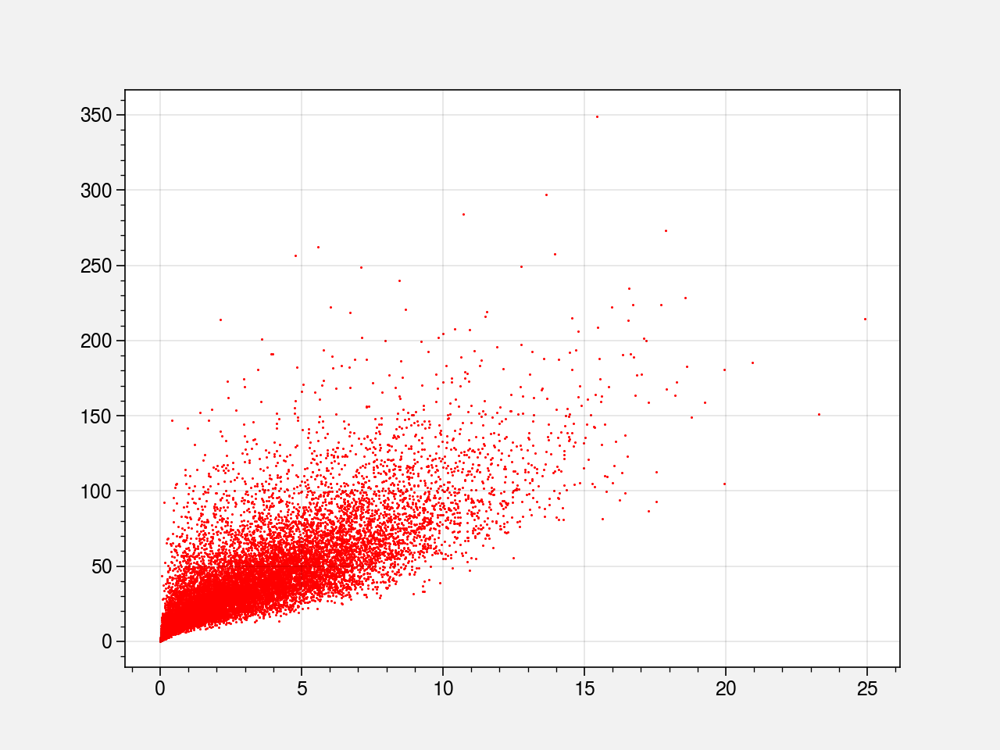

In [124]:
plt.scatter(np_dates[:,3],np_dates[:,4],color='r',marker='.',alpha=1,s=1)

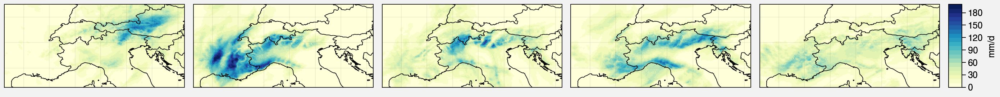

In [137]:
f, axs = pplt.subplots(proj='cyl',ncols=5)
for i in range(5):
    cb_prec=axs[i].pcolormesh(lon_,lat_,P[np.where(np_dates[:,3]>19)[0][i]],levels=np.linspace(0,200,21),cmap='YlGnBu')
f.colorbar(cb_prec,label= 'mm/d')
axs.format(**EUROCORDEX_format,suptitle='')

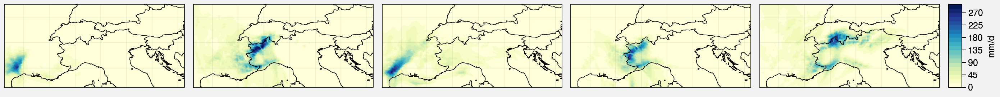

In [140]:
f, axs = pplt.subplots(proj='cyl',ncols=5)
for i in range(5):
    cb_prec=axs[i].pcolormesh(lon_,lat_,P[np.where(np_dates[:,4]>260)[0][i]],levels=np.linspace(0,300,21),cmap='YlGnBu')
f.colorbar(cb_prec,label= 'mm/d')
axs.format(**EUROCORDEX_format,suptitle='')

In [46]:
centroids_P,centroids_SLP,centroids_U,centroids_V = np.load('/home/philinat/Stage-M2/saved_clustering/centroids_data.npy')
dist_centroids = np.zeros((len(P),9,2))
for i in range(len(P)):
    for j in range(9):
        dist_centroids[i,j,0] = (1- np.sum(P[i]*centroids_P[j]) / np.sqrt(np.sum(P[i]**2)*np.sum(centroids_P[j]**2)))
        dist_centroids[i,j,1] = (1- np.sum(U[i]*centroids_U[j]+V[i]*centroids_V[j]) / np.sqrt(np.sum(U[i]**2+V[i]**2)*np.sum(centroids_U[j]**2+centroids_V[j]**2)))/2

In [3]:
P = np.random.exponential(10,(1000, 110, 163))
U = np.random.normal(0,10, (1000, 110, 163))
V = np.random.normal(0,10, (1000, 110, 163))

In [3]:
import xesmf as xe
ds_pr = xr.open_mfdataset('/bettik/philinat/EURO4M_APGD/APGD_*.nc')
ds_APGD = xr.open_dataset('/bettik/menegozm/EURO4M_APGD/06-coord_lonlat.nc').rename_vars({'Longitude':'LON','Latitude':'LAT'})

ds_in = xr.Dataset(
    data_vars=dict(prec=(["time","y","x"], ds_pr.PRECIPITATION.data)),
    coords=dict(lon=(["y","x"], ds_APGD.LON.data),
                lat=([ "y","x"], ds_APGD.LAT.data),
                time=ds_pr.time))

ds_out = xr.Dataset(
    coords=dict(lon=(["y","x"], lon_),
                lat=([ "y","x"], lat_),
                time=ds_pr.time))

regridder = xe.Regridder(ds_in, ds_out, 'bilinear')
ds_out = regridder(ds_in)

dates = ds_out.time
P = np.array(ds_out.prec.data)
print(np.shape(P))

centroids_P,centroids_SLP,centroids_U,centroids_V = np.load('/home/philinat/Stage-M2/saved_clustering/centroids_data.npy')
dist_centroids = np.zeros((len(P),9,1))
for i in range(len(P)):
    for j in range(9):
        dist_centroids[i,j,0] = (1- np.nansum(P[i]*centroids_P[j]) / np.sqrt(np.nansum(P[i]**2)*np.nansum(centroids_P[j]**2)))
        
np.save('/home/philinat/Stage-M2/saved_dist_centroids/APGD.npy',dist_centroids)
np_dates = np.transpose(np.array([dates.dt.year,dates.dt.month,dates.dt.day]))
np.save('/home/philinat/Stage-M2/saved_dist_centroids/dates_APGD.npy',np_dates)

/home/philinat/miniconda3/envs/erca/lib/python3.8/site-packages/xesmf/backend.py:36: UserWarning: Input array is not F_CONTIGUOUS. Will affect performance.
  warnings.warn("Input array is not F_CONTIGUOUS. "


Overwrite existing file: bilinear_138x243_110x163.nc 
 You can set reuse_weights=True to save computing time.
using dimensions ('y', 'x') from data variable prec as the horizontal dimensions for this dataset.


/home/philinat/miniconda3/envs/erca/lib/python3.8/site-packages/xesmf/frontend.py:477: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  ds_out = xr.apply_ufunc(


In [16]:
centroids_P,centroids_SLP,centroids_U,centroids_V = np.load('/home/philinat/Stage-M2/saved_clustering/centroids_data.npy')

files_year = ! ls {simulation+'MBrr.*.nc'}
year_start = int(files_year[0][-7:-3])
year_end = int(files_year[-1][-7:-3])
nyears = year_end-year_start+1

np_dates = np.zeros((nyears*366,3))
dist_centroids = np.zeros((nyears*366,9,2))
idd = 0
for y in range(year_start,year_end+1):
    print(y,end=' ')
    ds_rr = xr.open_dataset(simulation+'MBrr.'+str(y)+'.nc')
    ds_sf = xr.open_dataset(simulation+'MBsf.'+str(y)+'.nc')
    P = np.array(ds_rr.MBrr.data[:,jmin:jmax,imin:imax] + ds_sf.MBsf.data[:,jmin:jmax,imin:imax])
    U = np.array(xr.open_dataset(simulation+'UUz.'+str(y)+'.nc').UUz.data[:,2,jmin:jmax,imin:imax])
    V = np.array(xr.open_dataset(simulation+'VVz.'+str(y)+'.nc').VVz.data[:,2,jmin:jmax,imin:imax])
    dates = ds_rr.MBrr.time
    for i in range(len(dates)):
        for j in range(9):
            dist_centroids[idd,j,0] = (1- np.sum(P[i]*centroids_P[j]) / np.sqrt(np.sum(P[i]**2)*np.sum(centroids_P[j]**2)))
            dist_centroids[idd,j,1] = (1- np.sum(U[i]*centroids_U[j]+V[i]*centroids_V[j]) / np.sqrt(np.sum(U[i]**2+V[i]**2)*np.sum(centroids_U[j]**2+centroids_V[j]**2)))/2
        np_dates[idd,:] = np.array([dates.dt.year[i],dates.dt.month[i],dates.dt.day[i]])
        idd+=1
print(idd,nyears*366)
np_dates = np_dates[:idd]
dist_centroids = dist_centroids[:idd]

1902 1903 1904 1905 1906 1907 1908 1909 1910 1911 1912 1913 1914 1915 1916 1917 1918 1919 1920 1921 1922 1923 1924 1925 1926 1927 1928 1929 1930 1931 1932 1933 1934 1935 1936 1937 1938 1939 1940 1941 1942 1943 1944 1945 1946 1947 1948 1949 1950 1951 1952 1953 1954 1955 1956 1957 1958 1959 1960 1961 1962 1963 1964 1965 1966 1967 1968 1969 1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 39812 39894


In [143]:
# np.save('/home/philinat/Stage-M2/saved_dist_centroids/ERA20C.npy',dist_centroids)
np.save('/home/philinat/Stage-M2/saved_dist_centroids/dates_ERA20C.npy',np_dates)

# np.save('/home/philinat/Stage-M2/saved_dist_centroids/ERA5.npy',dist_centroids)
# np.save('/home/philinat/Stage-M2/saved_dist_centroids/dates_ERA5.npy',np_dates)

# np.save('/home/philinat/Stage-M2/saved_dist_centroids/MPI_HIST.npy',dist_centroids)
# np.save('/home/philinat/Stage-M2/saved_dist_centroids/dates_MPI_HIST.npy',np_dates)

# np.save('/home/philinat/Stage-M2/saved_dist_centroids/MPI_85.npy',dist_centroids)
# np.save('/home/philinat/Stage-M2/saved_dist_centroids/dates_MPI_85.npy',np_dates)

# np.save('/home/philinat/Stage-M2/saved_dist_centroids/ECE_HIST.npy',dist_centroids)
# np.save('/home/philinat/Stage-M2/saved_dist_centroids/dates_ECE_HIST.npy',np_dates)

# np.save('/home/philinat/Stage-M2/saved_dist_centroids/ECE_45.npy',dist_centroids)
# np.save('/home/philinat/Stage-M2/saved_dist_centroids/dates_ECE_45.npy',np_dates)

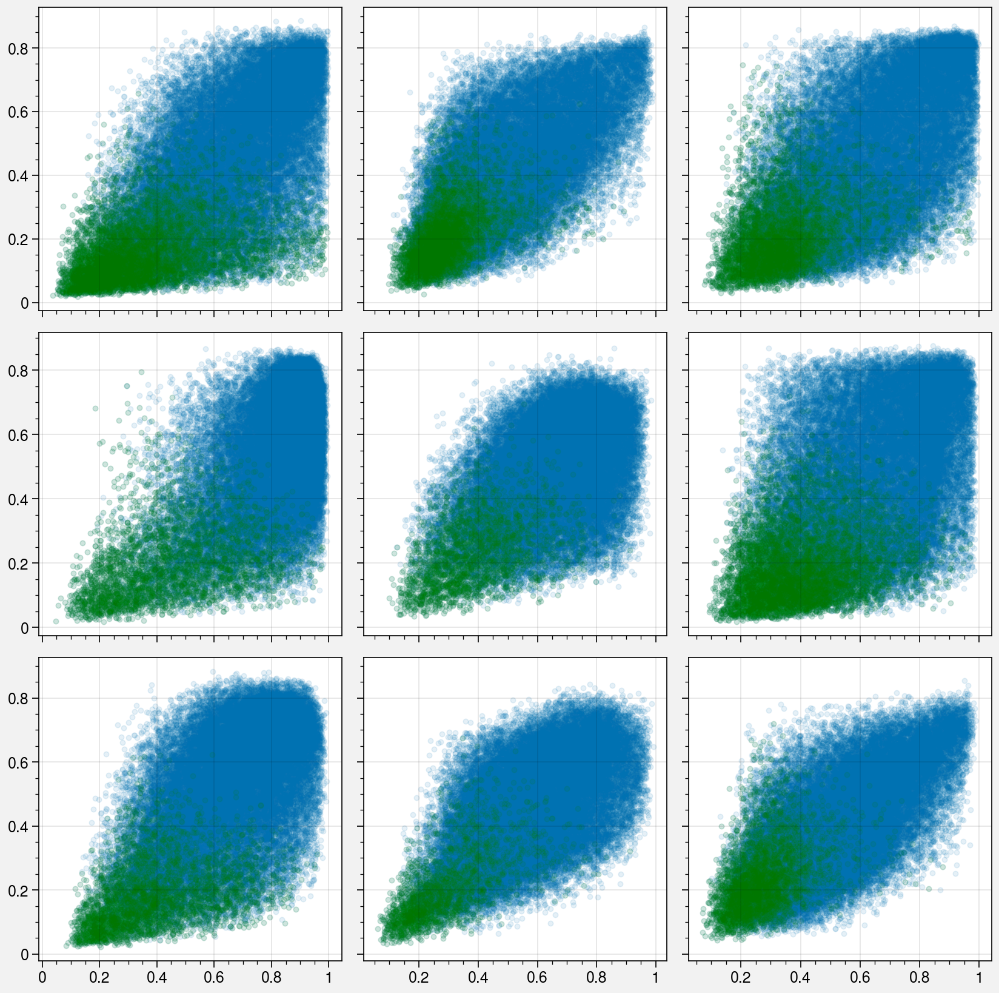

In [18]:
f,axs = pplt.subplots(nrows=3,ncols=3)
for i in range(9):
    axs[i].scatter(dist_centroids[:,i,0],dist_centroids[:,i,1],marker='.',alpha=0.1)
    # best = (dist_centroids[:,i,0] == np.min(dist_centroids[:,:,0],axis=1) )
    best = ( np.mean(dist_centroids[:,i,:],1) == np.min(np.mean(dist_centroids[:,:,:],2),axis=1) )
    axs[i].scatter(dist_centroids[best,i,0],dist_centroids[best,i,1],marker='.',alpha=0.1,color='g')

In [5]:
def get_classification(dist_centroids):
    classification = np.zeros(len(dist_centroids),dtype=int)
    for i in range(len(dist_centroids)):
        # if np.max(P[i]) ==0.:
        #     classification[i] = 9
        #     continue
        min_dist = 1. ; k=0
        for j in range(9):
            dist = np.mean(dist_centroids[i,j,:])
            # dist = dist_centroids[i,j,1]
            # dist = dist_centroids[i,j,0]
            if dist < min_dist:
                min_dist = dist ; k=j
        # if dist_centroids[i,k,1] < 0.5:
        if dist_centroids[i,k,1] < 0.5 and dist_centroids[i,k,0] < 0.5:
            classification[i] = k
        else:
            classification[i] = 9
    return classification

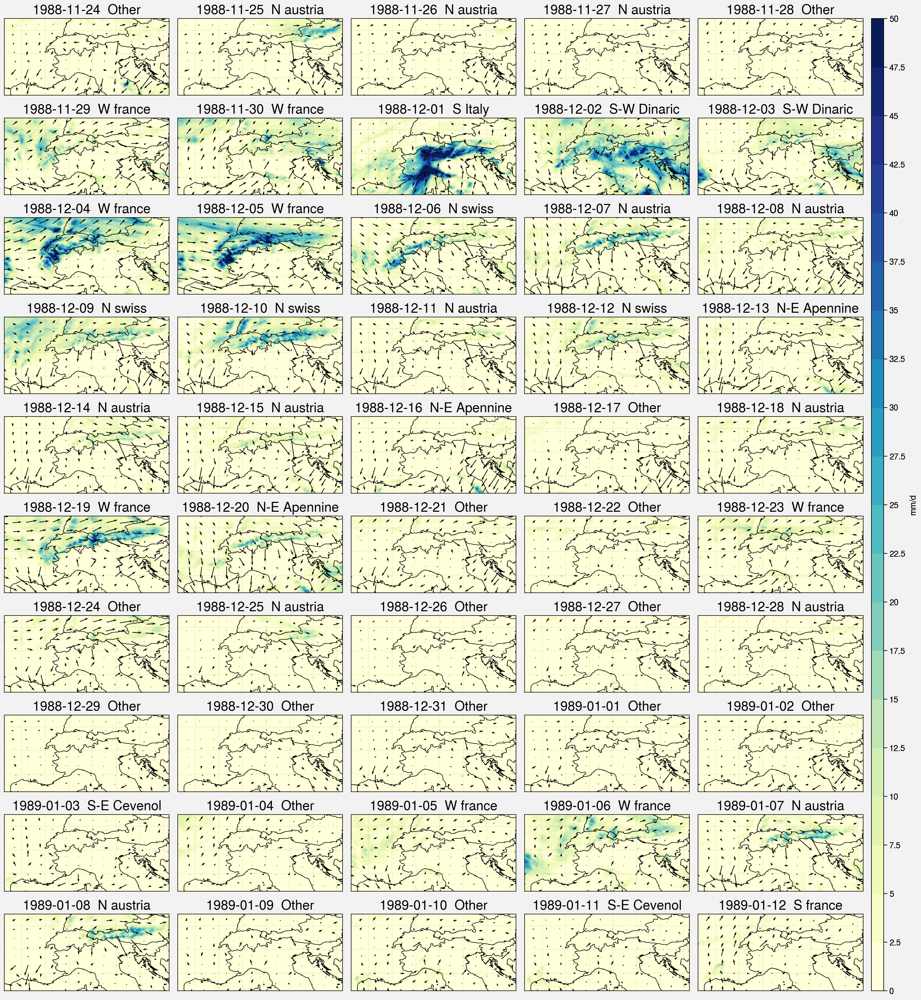

In [64]:
classification = get_classification(dist_centroids)

f, axs = pplt.subplots(proj='cyl',ncols=5, nrows=10)
for ax,i in enumerate(range(3250,3300)):
    cb_prec=axs[ax].pcolormesh(lon_,lat_,P[i],levels=np.linspace(0,50,21),cmap='YlGnBu')
    # cb_prec=axs[ax].pcolormesh(lon_,lat_,3.6*np.sqrt(U[i]**2+V[i]**2),levels=np.linspace(0,100,21),cmap='YlGnBu')
    axs[ax].format(title=str(dates.data[i])[:10] +'  '+ ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other'][classification[i]] ,titlesize='20px')
    step=12
    axs[ax].quiver(lon_[::step,::step],lat_[::step,::step],U[i,::step,::step],V[i,::step,::step],width=0.004,scale=200)
f.colorbar(cb_prec,label= 'mm/d')
# f.colorbar(cb_prec,label= 'km/h')
axs.format(**EUROCORDEX_format,suptitle='')

In [92]:
# plt.figure(figsize=(10,4))
names = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']
les_freqs = []
les_freqs_month = []
les_freqs_year = []
les_following_matrix = []

# models = ['ERA20C','ERA5','MPI_HIST','ECE_HIST','APGD']
models = ['ERA20C','ERA5','MPI_HIST','ECE_HIST']
# models = ['ERA5','MPI_HIST','MPI_85','ECE_HIST','ECE_45']
# models = ['ERA20C']
years = np.arange(1980,2009)
# years = np.arange(1902,2011)
for m in models:
    dist_centroids = np.load('/home/philinat/Stage-M2/saved_dist_centroids/'+m+'.npy')
    dates = np.load('/home/philinat/Stage-M2/saved_dist_centroids/dates_'+m+'.npy')
    
    selection_1980_2008 = np.logical_and(dates[:,0]>=years[0],dates[:,0]<=years[-1])
    dist_centroids = dist_centroids[selection_1980_2008,:,:]
    dates = dates[selection_1980_2008]
    
    classification = get_classification(dist_centroids)
    
    freqs = np.array([100*np.mean(classification==i) for i in range(10)])
    les_freqs.append(freqs)
    
    freq_month = np.zeros((10,12))
    for j,s in enumerate(range(1,13)):
        freq_month[:,j] = np.array([100*np.sum(np.logical_and(classification==i,dates[:,1]==s)) / np.sum(dates[:,1]==s) for i in range(10)])
    les_freqs_month.append(freq_month)
    
    freq_year = np.zeros((10,len(years)))
    for j,s in enumerate(years):
        freq_year[:,j] = np.array([100*np.sum(np.logical_and(classification==i,dates[:,0]==s)) / np.sum(dates[:,0]==s) for i in range(10)])
    les_freqs_year.append(freq_year)
    
    following_matrix = np.zeros((10,10),dtype=int)
    for i in range(1,len(classification)):
        following_matrix[classification[i-1],classification[i]] += 1
    les_following_matrix.append(following_matrix/(len(classification)-1)*100)
    
   


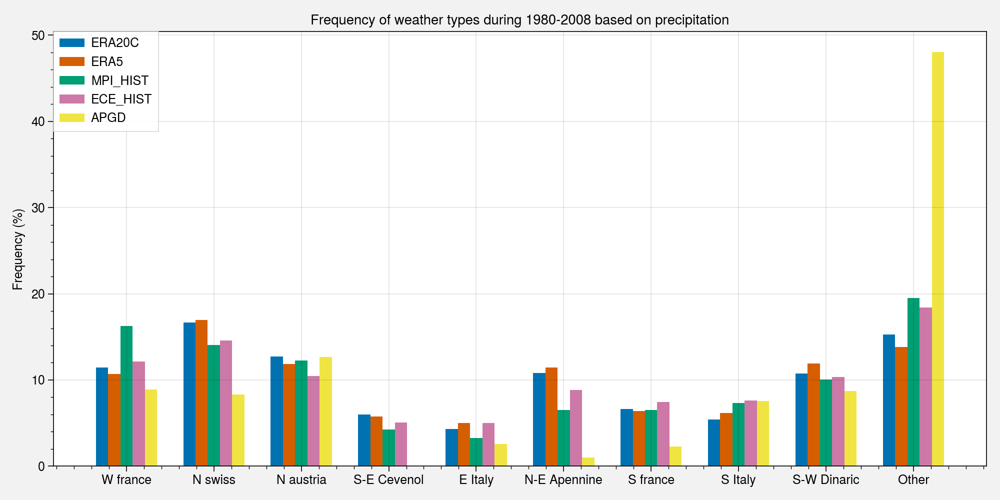

In [37]:
labels = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']

x = np.arange(len(labels))  # the label locations
width = 0.7/len(les_freqs)  # the width of the bars

fig, ax = plt.subplots(figsize=(10,5))
les_rects = []
for i,freqs in enumerate(les_freqs):
    les_rects.append(ax.bar(x + width*(i-(len(les_freqs)-1)/2), freqs, width, label=models[i]) )

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Frequency (%)')
ax.set_title('Frequency of weather types during 1980-2008 based on precipitation')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()


# def autolabel(rects):
#     """Attach a text label above each bar in *rects*, displaying its height."""
#     for rect in rects:
#         height = rect.get_height()
#         ax.annotate('{}'.format(int(round(height))),
#                     xy=(rect.get_x() + rect.get_width() / 2, height),
#                     xytext=(0, 3),  # 3 points vertical offset
#                     textcoords="offset points",
#                     ha='center', va='bottom')


# for rects in les_rects:
#     autolabel(rects)

fig.tight_layout()

plt.show()

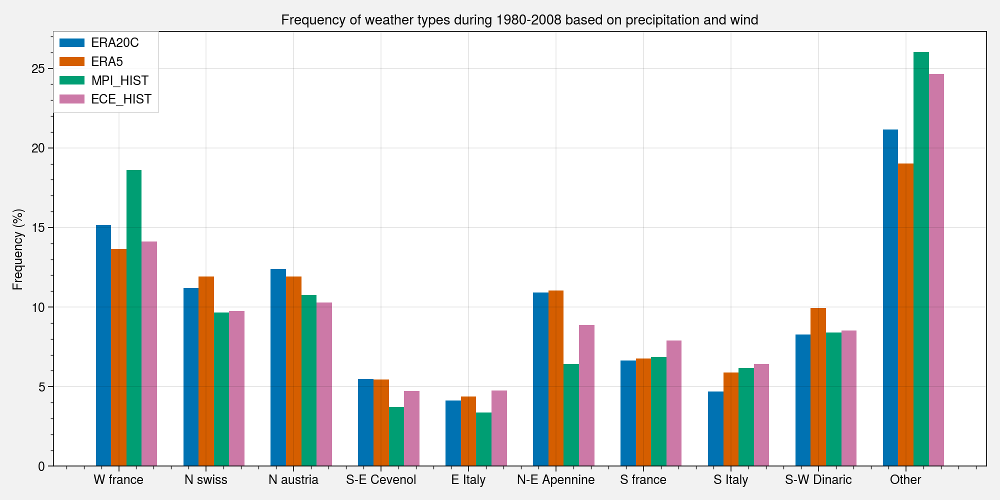

In [31]:
labels = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']
x = np.arange(len(labels))  # the label locations
width = 0.7/len(les_freqs)  # the width of the bars

fig, ax = plt.subplots(figsize=(10,5))
les_rects = []
for i,freqs in enumerate(les_freqs):
    les_rects.append(ax.bar(x + width*(i-(len(les_freqs)-1)/2), freqs, width, label=models[i]) )

ax.set_ylabel('Frequency (%)')
ax.set_title('Frequency of weather types during 1980-2008 based on precipitation and wind')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()
fig.tight_layout()

plt.show()

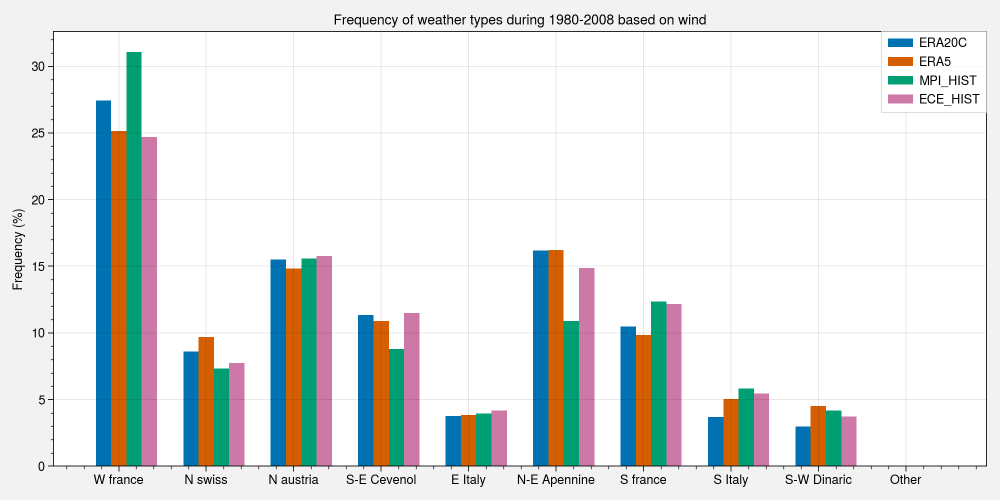

In [34]:
labels = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']
x = np.arange(len(labels))  # the label locations
width = 0.7/len(les_freqs)  # the width of the bars

fig, ax = plt.subplots(figsize=(10,5))
les_rects = []
for i,freqs in enumerate(les_freqs):
    les_rects.append(ax.bar(x + width*(i-(len(les_freqs)-1)/2), freqs, width, label=models[i]) )

ax.set_ylabel('Frequency (%)')
ax.set_title('Frequency of weather types during 1980-2008 based on wind')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()
fig.tight_layout()

plt.show()

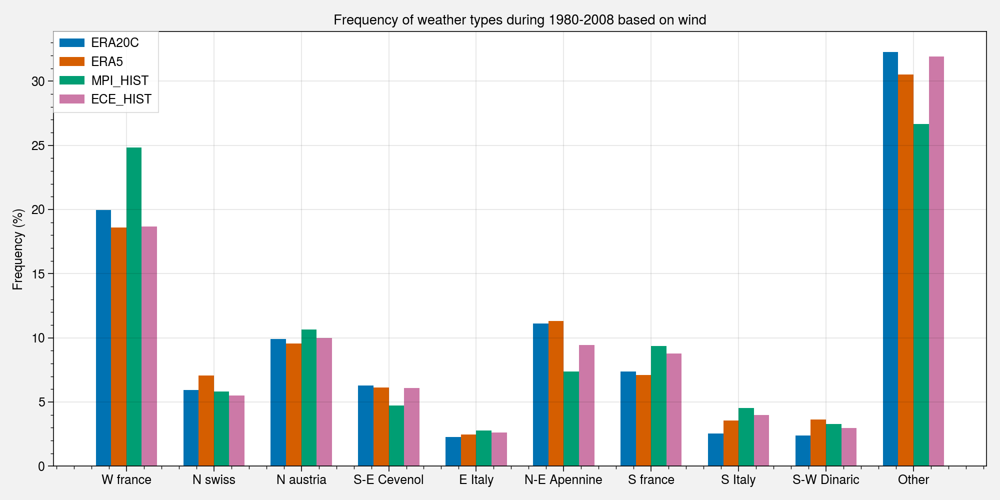

In [42]:
labels = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']
x = np.arange(len(labels))  # the label locations
width = 0.7/len(les_freqs)  # the width of the bars

fig, ax = plt.subplots(figsize=(10,5))
les_rects = []
for i,freqs in enumerate(les_freqs):
    les_rects.append(ax.bar(x + width*(i-(len(les_freqs)-1)/2), freqs, width, label=models[i]) )

ax.set_ylabel('Frequency (%)')
ax.set_title('Frequency of weather types during 1980-2008 based on wind')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()
fig.tight_layout()

plt.show()

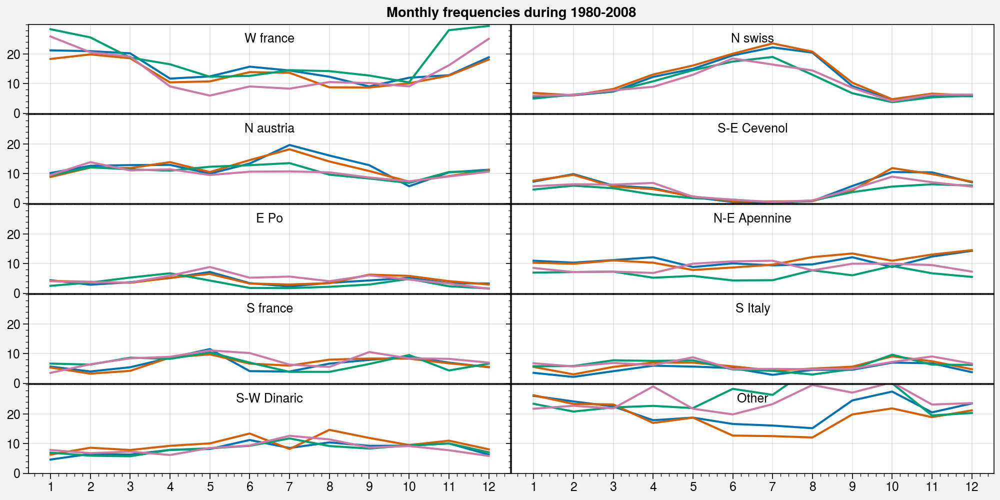

In [15]:
# names = ['W france','N swiss','N austria','S-E Cevenol','E Po','N-E Apennine','S france','S Italy','S-W Dinaric','Other']
f,axs = pplt.subplots(nrows = 5,ncols=2,figsize=(10,5),space=0.01)
for row in range(len(names)):
    axs[row].text(6.5,25,names[row],ha='center',va='center')
    axs[row].set_ylim((0,30))
    axs[row].set_xticks(np.arange(1,13))
    axs[row].set_yticks(np.arange(0,30,10))
    for i in range(len(models)):
        axs[row].plot(np.linspace(1,12,12),les_freqs_month[i][row,:])
axs.format(suptitle='Monthly frequencies during 1980-2008') 

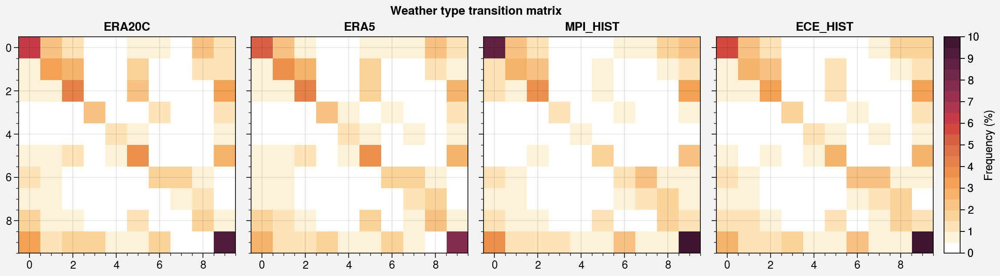

In [94]:
f,axs = pplt.subplots(ncols=len(models))
for i in range(len(models)):
    cb = axs[i].imshow(les_following_matrix[i],levels=np.linspace(0,10,21),cmap='fire')
f.colorbar(cb,label='Frequency (%)',)
axs.format(suptitle='Weather type transition matrix',collabels=models)

In [24]:
from matplotlib.patches import Arc, RegularPolygon
from numpy import radians as rad
def drawCirc(ax,radius,centX,centY,angle_,theta2_,color_='black',lw=10):
    #========Line
    arc = Arc([centX,centY],radius,radius,angle=angle_,
          theta1=0,theta2=theta2_,capstyle='round',linestyle='-',lw=lw,color=color_)
    ax.add_patch(arc)


    #========Create the arrow head
    endX=centX+(radius/2)*np.cos(rad(theta2_+angle_)) #Do trig to determine end position
    endY=centY+(radius/2)*np.sin(rad(theta2_+angle_))

    ax.add_patch(                    #Create triangle as arrow head
        RegularPolygon(
            (endX, endY),            # (x,y)
            3,                       # number of vertices
            lw/2.5,                # radius
            rad(angle_+theta2_),     # orientation
            color=color_
        )
    )
    
    # Make sure you keep the axes scaled or else arrow will distort

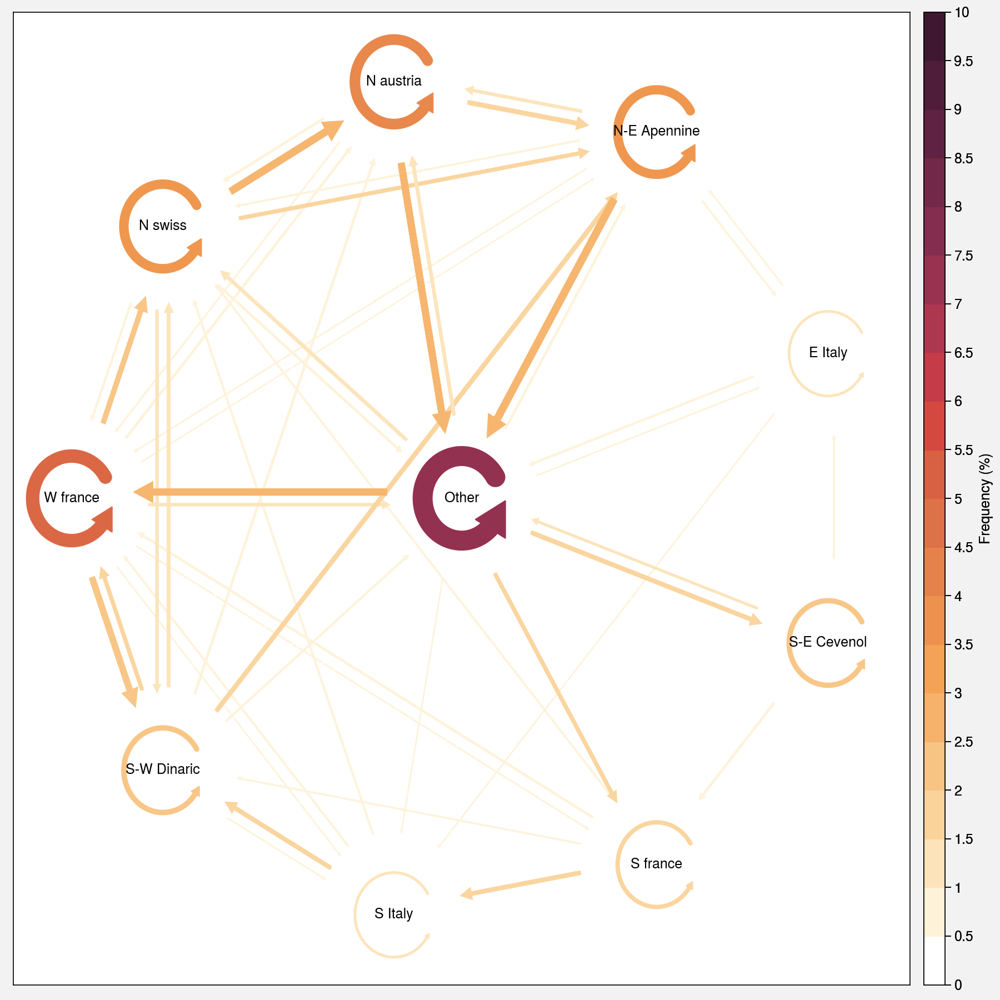

In [96]:
m = 1
names = ['W france','N swiss','N austria','N-E Apennine','E Italy','S-E Cevenol','S france','S Italy','S-W Dinaric','Other']
following_matrix = np.copy(les_following_matrix[m])
for i in range(len(names)):
    following_matrix[3,i],following_matrix[5,i] = following_matrix[5,i],following_matrix[3,i]
for i in range(len(names)):
    following_matrix[i,3],following_matrix[i,5] = following_matrix[i,5],following_matrix[i,3]
    
fig,ax = pplt.subplots(figsize=(9,9))
group_positions = np.zeros((len(names),2))
def get_color(fm,cmap='fire',max_color = 10,step=0.5):
    return (cmap,int(min(max_color,fm)/step)*step/max_color)
scaling=0.6#scaling=60
for i in range(len(names)-1):
    angle= np.pi*2*i/(len(names)-1)
    group_positions[i] = 100*np.array([-np.cos(angle),np.sin(angle) ])
for i in range(len(names)):
    drawCirc(ax,20,group_positions[i,0],group_positions[i,1],30,300,lw=following_matrix[i,i]/scaling,color_=get_color(following_matrix[i,i]))
    ax.text(group_positions[i,0],group_positions[i,1],names[i],va='center',ha='center')
for i in range(len(names)):
    for j in range(len(names)):
        if i!=j:# and following_matrix[i,j]>scaling:
            x0 = group_positions[i,0] ; y0 = group_positions[i,1]
            dx = group_positions[j,0]-x0 ; dy = group_positions[j,1]-y0
            d = np.sqrt(dx**2+dy**2)
            lw=following_matrix[i,j]/scaling
            dc = 20 # Distance of the arrow from the circle
            ds = 3 # Distance between two twin arrows
            color = get_color(following_matrix[i,j])
            ax.arrow(x0+dc*dx/d+ds/2*dy/d, y0+dc*dy/d-ds/2*dx/d, dx-2*dc*dx/d, dy-2*dc*dy/d, lw=lw,head_width=lw/2, head_length=lw/2, fc=color, ec=color,zorder=int(lw))
ax.set_xlim([-115,115]) and ax.set_ylim([-115,115]) 
ax.grid(False)
ax.set_xticks([])
ax.set_yticks([])
fig.colorbar(cb,label='Frequency (%)')

In [21]:
dist_centroids = np.load('/home/philinat/Stage-M2/saved_dist_centroids/ERA5.npy')
classification = get_classification(dist_centroids)

max_type_year = np.zeros((41,110, 163))
for y,year in enumerate(range(1980,2021)):
    first = np.where(np_dates[:,0]==year)[0][0]
    max_type_year[y] = np.argmax(P[np_dates[:,0]==year],axis=0)
    for j in range(110):
        for i in range(163):
            max_type_year[y,j,i] = classification[ first + int(max_type_year[y,j,i]) ]

dominant_type = -np.ones((110, 163))
for typ in range(10):
    dominant = ( np.sum(max_type_year==typ,axis=0)/41 >0.4)
    dominant_type[dominant] = typ

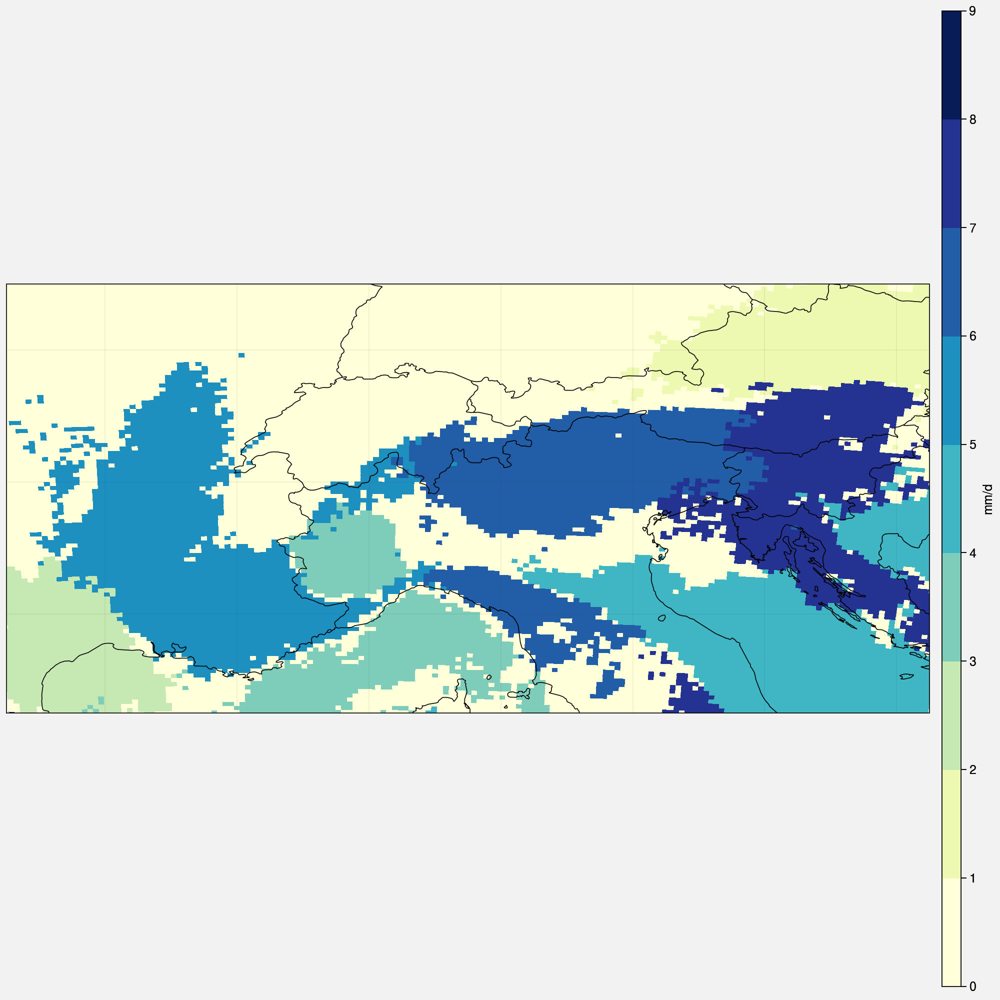

In [23]:
f, ax = pplt.subplots(proj='cyl',ncols=1, nrows=1,figsize=(10,10))
cb_prec=ax.pcolormesh(lon_,lat_,dominant_type,levels=np.linspace(-1,9,10),cmap='YlGnBu')

f.colorbar(cb_prec,label= 'mm/d')
# f.colorbar(cb_prec,label= 'km/h')
ax.format(**EUROCORDEX_format,suptitle='')

In [25]:
names = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']

les_freqs_year = []
les_years = []
models = ['ERA20C','ERA5','MPI_85','ECE_45']
years = np.arange(1980,2009)
for m in models:
    if m in ['MPI_85','ECE_45']:
        dist_centroids = np.concatenate((np.load('/home/philinat/Stage-M2/saved_dist_centroids/'+m[:3]+'_HIST.npy'),np.load('/home/philinat/Stage-M2/saved_dist_centroids/'+m+'.npy')))
        dates = np.concatenate((np.load('/home/philinat/Stage-M2/saved_dist_centroids/dates_'+m[:3]+'_HIST.npy'),np.load('/home/philinat/Stage-M2/saved_dist_centroids/dates_'+m+'.npy')))
    else:
        dist_centroids = np.load('/home/philinat/Stage-M2/saved_dist_centroids/'+m+'.npy')
        dates = np.load('/home/philinat/Stage-M2/saved_dist_centroids/dates_'+m+'.npy')
        
    classification = get_classification(dist_centroids)
    years = np.arange(dates[0,0],dates[-1,0]+1)
    les_years.append(years)
    freq_year = np.zeros((10,len(years)))
    for j,s in enumerate(years):
        freq_year[:,j] = np.array([100*np.sum(np.logical_and(classification==i,dates[:,0]==s)) / np.sum(dates[:,0]==s) for i in range(10)])
    les_freqs_year.append(freq_year)

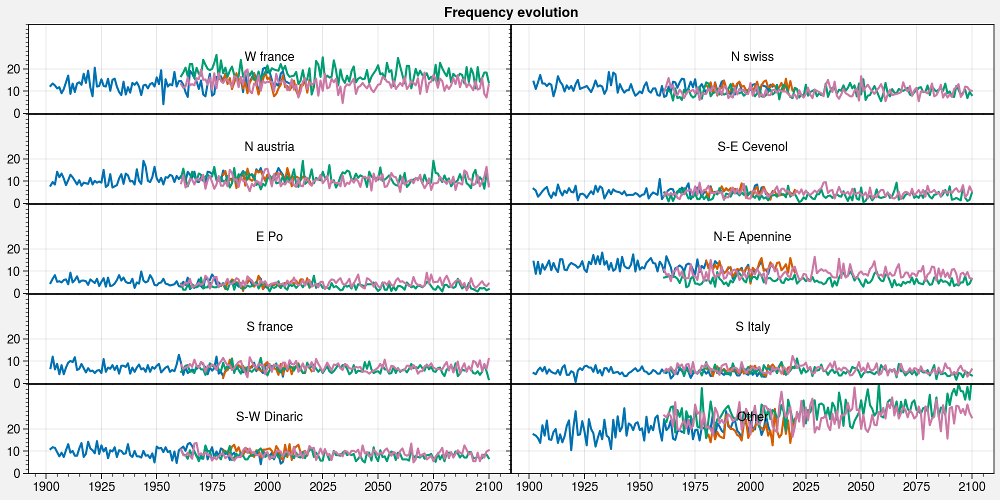

In [31]:
m=20
sm = int(m/2)
les_freqs_year_smooth = [np.copy(freq_year) for freq_year in les_freqs_year]
for model,freq_year in enumerate(les_freqs_year):
    ng,nt = np.shape(freq_year)
    for j in range(ng):
        for i in range(nt):
            if i>=sm and i<nt-m+sm:
                les_freqs_year_smooth[model][j,i] = np.mean(freq_year[j,i-sm:i-sm+m])
            elif i<sm:
                les_freqs_year_smooth[model][j,i] = np.mean(freq_year[j,:i-sm+m])
            elif i>=nt-m+sm:
                les_freqs_year_smooth[model][j,i] = np.mean(freq_year[j,i-sm:])

f,axs = pplt.subplots(nrows = 5,ncols=2,figsize=(10,5),space=0.01)
for row in range(len(names)):
    axs[row].text(2001,25,names[row],ha='center',va='center')
    axs[row].set_ylim((0,40))
    # axs[row].set_xticks(np.arange(1,13))
    axs[row].set_yticks(np.arange(0,30,10))
    for i in range(len(models)):
        axs[row].plot(les_years[i],les_freqs_year[i][row,:])
axs.format(suptitle='Frequency evolution')

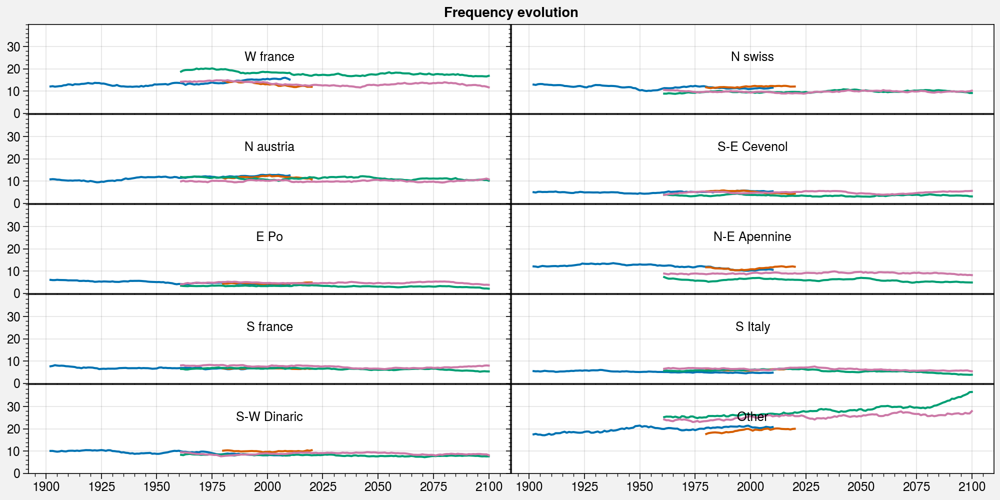

In [30]:
f,axs = pplt.subplots(nrows = 5,ncols=2,figsize=(10,5),space=0.01)
for row in range(len(names)):
    axs[row].text(2001,25,names[row],ha='center',va='center')
    axs[row].set_ylim((0,40))
    # axs[row].set_xticks(np.arange(1,13))
    axs[row].set_yticks(np.arange(0,31,10))
    for i in range(len(models)):
        axs[row].plot(les_years[i],les_freqs_year_smooth[i][row,:])
axs.format(suptitle='Frequency evolution')

In [32]:
# plt.figure(figsize=(10,4))
names = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']
les_freqs = []
les_freqs_month = []
models = ['MPI_85','ECE_45']
years = np.arange(2090,2101)
for m in models:
    dist_centroids = np.load('/home/philinat/Stage-M2/saved_dist_centroids/'+m+'.npy')
    dates = np.load('/home/philinat/Stage-M2/saved_dist_centroids/dates_'+m+'.npy')
    
    selection = np.logical_and(dates[:,0]>=years[0],dates[:,0]<=years[-1])
    dist_centroids = dist_centroids[selection,:,:]
    dates = dates[selection]
    
    classification = get_classification(dist_centroids)
    
    freqs = np.array([100*np.mean(classification==i) for i in range(10)])
    les_freqs.append(freqs)
    
    freq_month = np.zeros((10,12))
    for j,s in enumerate(range(1,13)):
        freq_month[:,j] = np.array([100*np.sum(np.logical_and(classification==i,dates[:,1]==s)) / np.sum(dates[:,1]==s) for i in range(10)])
    les_freqs_month.append(freq_month)

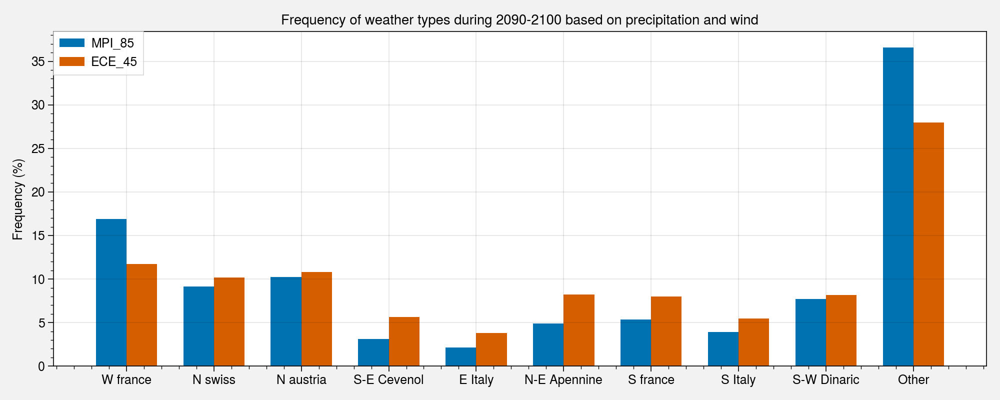

In [35]:
labels = ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other']
x = np.arange(len(labels))  # the label locations
width = 0.7/len(les_freqs)  # the width of the bars

fig, ax = plt.subplots(figsize=(10,4))
les_rects = []
for i,freqs in enumerate(les_freqs):
    les_rects.append(ax.bar(x + width*(i-(len(les_freqs)-1)/2), freqs, width, label=models[i]) )

ax.set_ylabel('Frequency (%)')
ax.set_title('Frequency of weather types during 2090-2100 based on precipitation and wind')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()
fig.tight_layout()

plt.show()

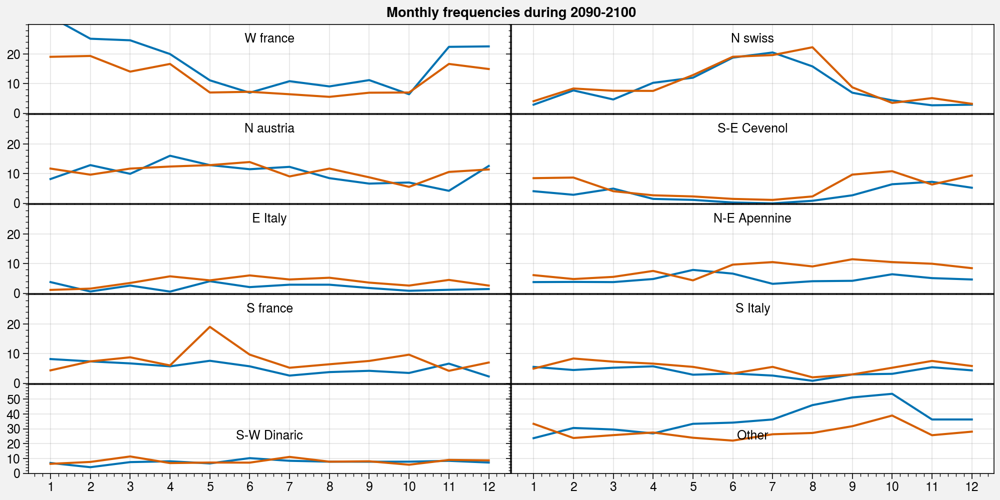

In [41]:
f,axs = pplt.subplots(nrows = 5,ncols=2,figsize=(10,5),space=0.01)
for row in range(len(names)):
    axs[row].text(6.5,25,names[row],ha='center',va='center')
    if row==len(names)-1:
        axs[row].set_ylim((0,60))
        axs[row].set_yticks(np.arange(0,60,10))
    else:
        axs[row].set_ylim((0,30))
        axs[row].set_yticks(np.arange(0,30,10))
    axs[row].set_xticks(np.arange(1,13))
    
    for i in range(len(models)):
        axs[row].plot(np.linspace(1,12,12),les_freqs_month[i][row,:])
axs.format(suptitle='Monthly frequencies during 2090-2100') 

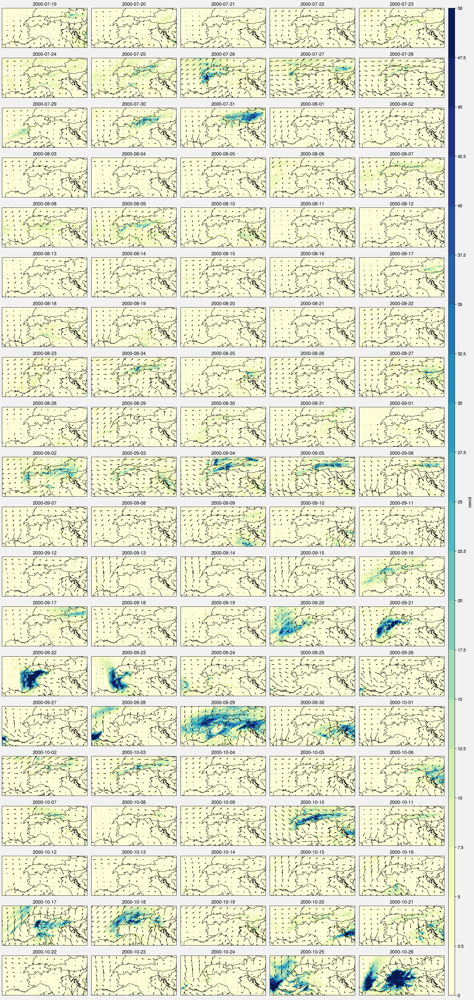

In [45]:
simulation = '/bettik/beaumetj/MARout/MAR-MPI-ESM1-2-HR/HIST/daily/ICE.MPI-ESM_HIST.EUy.'
y=2000
ds_rr = xr.open_dataset(simulation+'MBrr.'+str(y)+'.nc')
ds_sf = xr.open_dataset(simulation+'MBsf.'+str(y)+'.nc')
P = np.array(ds_rr.MBrr.data[:,jmin:jmax,imin:imax] + ds_sf.MBsf.data[:,jmin:jmax,imin:imax])
U = np.array(xr.open_dataset(simulation+'UUz.'+str(y)+'.nc').UUz.data[:,2,jmin:jmax,imin:imax])
V = np.array(xr.open_dataset(simulation+'VVz.'+str(y)+'.nc').VVz.data[:,2,jmin:jmax,imin:imax])
dates = ds_rr.MBrr.time

# classification = get_classification(dist_centroids)

f, axs = pplt.subplots(proj='cyl',ncols=5, nrows=20)
for ax,i in enumerate(range(200,300)):
    cb_prec=axs[ax].pcolormesh(lon_,lat_,P[i],levels=np.linspace(0,50,21),cmap='YlGnBu')
    # cb_prec=axs[ax].pcolormesh(lon_,lat_,3.6*np.sqrt(U[i]**2+V[i]**2),levels=np.linspace(0,100,21),cmap='YlGnBu')
    axs[ax].format(title=str(dates.data[i])[:10] )#+'  '+ ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other'][classification[i]] ,titlesize='20px')
    step=12
    axs[ax].quiver(lon_[::step,::step],lat_[::step,::step],U[i,::step,::step],V[i,::step,::step],width=0.004,scale=200)
f.colorbar(cb_prec,label= 'mm/d')
# f.colorbar(cb_prec,label= 'km/h')
axs.format(**EUROCORDEX_format,suptitle='')

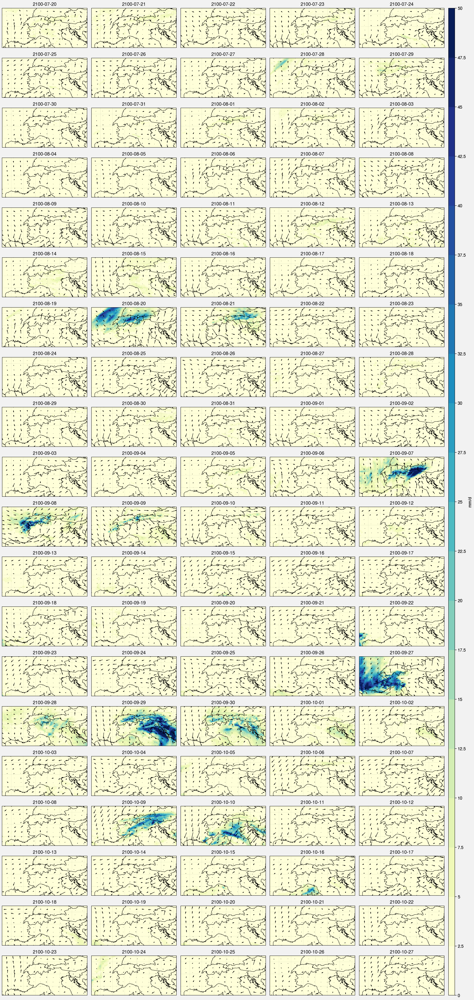

In [44]:
simulation = '/bettik/beaumetj/MARout/MAR-MPI-ESM1-2-HR/SSP585/daily/ICE.MPI-ESM_SSP585.EUy.'
y=2100
ds_rr = xr.open_dataset(simulation+'MBrr.'+str(y)+'.nc')
ds_sf = xr.open_dataset(simulation+'MBsf.'+str(y)+'.nc')
P = np.array(ds_rr.MBrr.data[:,jmin:jmax,imin:imax] + ds_sf.MBsf.data[:,jmin:jmax,imin:imax])
U = np.array(xr.open_dataset(simulation+'UUz.'+str(y)+'.nc').UUz.data[:,2,jmin:jmax,imin:imax])
V = np.array(xr.open_dataset(simulation+'VVz.'+str(y)+'.nc').VVz.data[:,2,jmin:jmax,imin:imax])
dates = ds_rr.MBrr.time

# classification = get_classification(dist_centroids)

f, axs = pplt.subplots(proj='cyl',ncols=5, nrows=20)
for ax,i in enumerate(range(200,300)):
    cb_prec=axs[ax].pcolormesh(lon_,lat_,P[i],levels=np.linspace(0,50,21),cmap='YlGnBu')
    # cb_prec=axs[ax].pcolormesh(lon_,lat_,3.6*np.sqrt(U[i]**2+V[i]**2),levels=np.linspace(0,100,21),cmap='YlGnBu')
    axs[ax].format(title=str(dates.data[i])[:10] )#+'  '+ ['W france','N swiss','N austria','S-E Cevenol','E Italy','N-E Apennine','S france','S Italy','S-W Dinaric','Other'][classification[i]] ,titlesize='20px')
    step=12
    axs[ax].quiver(lon_[::step,::step],lat_[::step,::step],U[i,::step,::step],V[i,::step,::step],width=0.004,scale=200)
f.colorbar(cb_prec,label= 'mm/d')
# f.colorbar(cb_prec,label= 'km/h')
axs.format(**EUROCORDEX_format,suptitle='')